# Brownian Motion Anomaly Detection

This project explores the effectiveness of isolation forests, a type of ensemble decision tree ML algorithm, for detecting anomalies in a physics-informed environment. This is tested against Brownian Motion, the random movement of particles suspended in a fluid. Particles in the fluid are in constant random motion, colliding with other suspended particles and causing erratic movement as a result, a great example of how kinetic theory operates on a molecular scale.

### Brownian Motion Simulation

This is a basic simulation of Brownian motion. It can be thought of as a random walk in 2D, where the algorithm takes a random length step at a random angle. This is done for 1000 particles

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

n_particles = 1000        
timesteps = 500           
dt = 1.0                  # time step size
mu = 0                    # drift
sigma = 1                 # volatility
anomaly_fraction = 0.1    # % of particles to inject anomalies into

'''SIMULATING BROWNIAN MOTION'''
def simulate_brownian(n, t, mu, sigma, dt):
    steps = np.random.normal(loc=mu*dt, scale=sigma*np.sqrt(dt), size=(n, t, 2))
    return np.cumsum(steps, axis=1)  # Cumulative sum gives the trajectory

trajectories = simulate_brownian(n_particles, timesteps, mu, sigma, dt)

### Anomaly Injection

To measure how good the Isolation Forest is at detecting anomalies, we inject artificial spikes to the simulated particles and then track how well the ML algorithm responds. This will later be done using a confusion matrix

In [6]:
'''INJECTING ANOMALIES''' 
n_anomalous = int(anomaly_fraction * n_particles)
anomalous_indices = np.random.choice(n_particles, n_anomalous, replace=False)

for idx in anomalous_indices:
    # Inject a spike or noise burst at a random point in the trajectory
    spike_time = np.random.randint(low=100, high=timesteps-50)
    noise = np.random.normal(0, 10 * sigma, size=(10, 2))  # big jump
    trajectories[idx, spike_time:spike_time+10] += noise

# Format into DataFrame
data = []
for i in range(n_particles):
    for t in range(timesteps):
        data.append({
            "particle_id": i,
            "timestep": t,
            "x": trajectories[i, t, 0],
            "y": trajectories[i, t, 1],
            "is_anomalous": int(i in anomalous_indices)
        })

df = pd.DataFrame(data)

### Brownian Motion Demo Visualization

Here's a quick plot of what Brownian Motion in 2D looks like

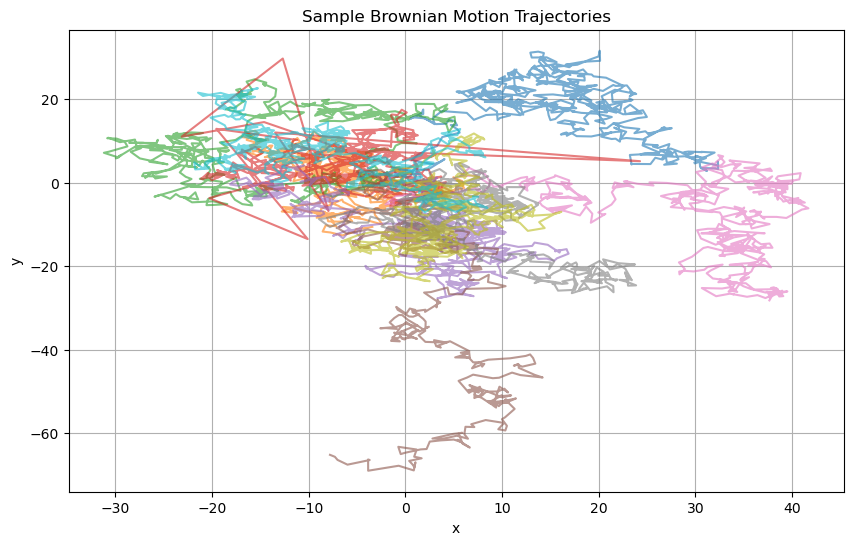

In [8]:
# Quick plot of sample trajectories
plt.figure(figsize=(10, 6))
for pid in np.random.choice(n_particles, size=10, replace=False):
    plt.plot(df[df.particle_id == pid].x, df[df.particle_id == pid].y, alpha=0.6)
plt.title("Sample Brownian Motion Trajectories")
plt.xlabel("x"); plt.ylabel("y")
plt.grid(True)
plt.show()

# Isolation Forests

Isolation Forests, a type of unsupervised machine learning algorithm, is an ensemble decision tree method that excels at detecting quantitative anomalies in high dimensions and large datasets. Each individual decision tree segments the data with each step, continuously splitting until a singular point is isolated in one leaf node. Anomaly points on average tend to be segmented faster than others, and so this leaf node is categorized as an anomaly.

In case a single tree miscategorizes a datapoint, iso forests use an ensemble to "vote" on which points are actually an anomaly, so the forest is able to detect anomalies in a probabilistic fashion.

### Feature Engineering

Now that we have the base simulation of the Brownian Motion with the added anomalies, we can go ahead and engineer the features to implement the ML algorithm. The main features we look out for are two kinematic variables in physics: speed and acceleration. These features are then aggregated for each particle

In [11]:
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler

'''COMPUTING FEATURES'''
df['vx'] = df.groupby('particle_id')['x'].diff().fillna(0)
df['vy'] = df.groupby('particle_id')['y'].diff().fillna(0)
df['speed'] = np.sqrt(df['vx']**2 + df['vy']**2)
df['acceleration'] = df.groupby('particle_id')['speed'].diff().fillna(0)

# Aggregate stats per particle
features = df.groupby('particle_id')[['speed', 'acceleration']].agg(['mean', 'std', 'max']).reset_index()
features.columns = ['particle_id'] + [f"{stat}_{feat}" for feat in ['speed', 'acceleration'] for stat in ['mean', 'std', 'max']]

### Isolation Forest Implementation

The isolation forest is then implemented with each of these features, and the model results are merged back into the main dataframe. Since the fraction of particles that experience an anomaly is set to 10%, the contamination rate for this model will also be set at 10%. 

In [13]:
'''ISO FOREST IMPLEMENTATION'''
X = features.drop(columns=['particle_id'])
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

iso = IsolationForest(contamination=0.1, random_state=42)
features['anomaly_score'] = iso.fit_predict(X_scaled)  # -1 = anomaly, 1 = normal

# Merge back with original DataFrame
df = df.merge(features[['particle_id', 'anomaly_score']], on='particle_id', how='left')

### Model Evaluation

To assess how well the model performed, we use a confusion matrix to evaluate the performance of a classification model by comparing its predictions against the actual values (true positives, true negatives, false positives, false negatives)

In [15]:
from sklearn.metrics import classification_report, confusion_matrix

# Map IsolationForest output (-1 = anomaly, 1 = normal) to binary labels
features['predicted_anomaly'] = (features['anomaly_score'] == -1).astype(int)

# Get true labels from earlier
features = features.merge(df[['particle_id', 'is_anomalous']].drop_duplicates(), on='particle_id')

# Print evaluation metrics
print(confusion_matrix(features['is_anomalous'], features['predicted_anomaly']))
print(classification_report(features['is_anomalous'], features['predicted_anomaly'], digits=3))


[[899   1]
 [  1  99]]
              precision    recall  f1-score   support

           0      0.999     0.999     0.999       900
           1      0.990     0.990     0.990       100

    accuracy                          0.998      1000
   macro avg      0.994     0.994     0.994      1000
weighted avg      0.998     0.998     0.998      1000



# Animation

To visualize how the model works, the timesteps are animated below. Normal movement is shown as blue, while anomalies are shown as red

In [17]:
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

sample_ids = df['particle_id'].unique()[:10]
df_anim = df[df['particle_id'].isin(sample_ids)].copy()

# Ensure anomaly labels per timestep exist
df_anim['is_frame_anomaly'] = 0

# Inject local spike anomaly flags (not just per particle)
for pid in sample_ids:
    # Find spikes by diff in speed or acceleration above some threshold
    particle = df_anim[df_anim['particle_id'] == pid]
    spike_times = particle[particle['speed'] > particle['speed'].mean() + 3*particle['speed'].std()]['timestep']
    df_anim.loc[(df_anim['particle_id'] == pid) & (df_anim['timestep'].isin(spike_times)), 'is_frame_anomaly'] = 1

# Set up figure
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(df_anim['x'].min() - 1, df_anim['x'].max() + 1)
ax.set_ylim(df_anim['y'].min() - 1, df_anim['y'].max() + 1)
ax.set_title("Brownian Motion with Local Anomaly Highlighting")
ax.set_xlabel("x")
ax.set_ylabel("y")

# Initialize plot handles (lines split into normal/anomalous segments)
lines_normal = {}
lines_anomaly = {}
for pid in sample_ids:
    lines_normal[pid], = ax.plot([], [], lw=2, color='tab:blue')
    lines_anomaly[pid], = ax.plot([], [], lw=2, color='tab:red')

def init():
    for line in list(lines_normal.values()) + list(lines_anomaly.values()):
        line.set_data([], [])
    return list(lines_normal.values()) + list(lines_anomaly.values())

def update(frame):
    for pid in sample_ids:
        traj = df_anim[(df_anim['particle_id'] == pid) & (df_anim['timestep'] <= frame)]
        if not traj.empty:
            normal = traj[traj['is_frame_anomaly'] == 0]
            anomaly = traj[traj['is_frame_anomaly'] == 1]

            lines_normal[pid].set_data(normal['x'], normal['y'])
            lines_anomaly[pid].set_data(anomaly['x'], anomaly['y'])
    return list(lines_normal.values()) + list(lines_anomaly.values())

ani = animation.FuncAnimation(fig, update, frames=timesteps, init_func=init,
                              blit=True, interval=30, repeat=False)

HTML(ani.to_jshtml())


Animation size has reached 21031713 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [30]:
pip install ffmpeg pillow

Note: you may need to restart the kernel to use updated packages.


In [32]:
from matplotlib.animation import PillowWriter

ani.save("brownian_anomalies.gif", writer=PillowWriter(fps=30))